In [ ]:
!ls -altrh /Users/pmulrooney/Downloads/

In [134]:
import pandas as pd
import time
import os
import matplotlib.pyplot as plt
import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon

# To display inline image below
from IPython.display import Image


%matplotlib inline

In [89]:
pd.set_option('display.max_rows', 120)

In [90]:
df_orig = pd.read_csv('/Users/pmulrooney/Downloads/COVID-19_Statistics_by_ZIP_Code.csv')

In [91]:
df_orig.head()

,X,Y,FID,zipcode_zip,ziptext,case_count,updatedate,created_date,created_user,last_edited_date,last_edited_user,globalid
0,-1.299049e+07,3.869543e+06,1,91901,91901,1.0,2020/04/01 08:00:00,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,{87C2AEFB-2AB8-473D-BE60-B021F0AD990A}
1,-1.302606e+07,3.851793e+06,2,91902,91902,9.0,2020/04/01 08:00:00,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,{0BBF31F5-A98F-4A42-869E-F425379D6BA8}
2,-1.303169e+07,3.847143e+06,3,91910,91910,23.0,2020/04/01 08:00:00,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,{94FEB6AB-AB77-4534-9692-CF8DFC823461}
3,-1.302997e+07,3.843296e+06,4,91911,91911,21.0,2020/04/01 08:00:00,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,{83793CC0-427A-4747-9BDD-5D79A947C3FF}
4,-1.302299e+07,3.844480e+06,5,91913,91913,20.0,2020/04/01 08:00:00,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,{597D4C08-7AD1-49D2-811D-D54EE7C2BB13}


In [92]:
print(df_orig.columns)
print(df_orig.shape)

Index(['X', 'Y', 'FID', 'zipcode_zip', 'ziptext', 'case_count', 'updatedate',
       'created_date', 'created_user', 'last_edited_date', 'last_edited_user',
       'globalid'],
      dtype='object')
(6501, 12)


In [93]:
df_orig['date'] = df_orig['updatedate'].apply(lambda x: x.split(" ")[0])
df_orig.drop(inplace=True, columns=['X','Y','FID','ziptext','created_date','updatedate','created_user','last_edited_date','last_edited_user','globalid'])

In [94]:
print(df_orig.shape)
print(df_orig.head())

(6501, 3)
   zipcode_zip  case_count        date
0        91901         1.0  2020/04/01
1        91902         9.0  2020/04/01
2        91910        23.0  2020/04/01
3        91911        21.0  2020/04/01
4        91913        20.0  2020/04/01


In [95]:
print(df_orig.describe())
print("--------")
print(df_orig.isna().sum())

        zipcode_zip   case_count
count   6501.000000  5564.000000
mean   92061.392863    38.104242
std      104.278744    60.927895
min    91901.000000     1.000000
25%    92008.000000     8.000000
50%    92067.000000    20.000000
75%    92116.000000    42.000000
max    92672.000000   648.000000
--------
zipcode_zip      0
case_count     937
date             0
dtype: int64


In [96]:
df_orig = df_orig.fillna(0)

In [97]:
print(df_orig.describe())
print("--------")
print(df_orig.isna().sum())

        zipcode_zip   case_count
count   6501.000000  6501.000000
mean   92061.392863    32.612214
std      104.278744    57.932841
min    91901.000000     0.000000
25%    92008.000000     3.000000
50%    92067.000000    15.000000
75%    92116.000000    36.000000
max    92672.000000   648.000000
--------
zipcode_zip    0
case_count     0
date           0
dtype: int64


In [98]:
df_orig.groupby('date')['zipcode_zip'].count()

date
2020/03/30     79
2020/03/31     82
2020/04/01     87
2020/04/02     88
2020/04/03     88
2020/04/04     88
2020/04/05    113
2020/04/06    113
2020/04/07    113
2020/04/08    113
2020/04/09    113
2020/04/10    113
2020/04/11    113
2020/04/12    113
2020/04/13    113
2020/04/14    113
2020/04/15    113
2020/04/16    113
2020/04/17    113
2020/04/18    113
2020/04/19    113
2020/04/20    113
2020/04/21    113
2020/04/22    113
2020/04/23    113
2020/04/24    113
2020/04/25    113
2020/04/26    113
2020/04/27    113
2020/04/28    113
2020/04/29    113
2020/04/30    113
2020/05/01    113
2020/05/02    113
2020/05/03    113
2020/05/04    113
2020/05/05    113
2020/05/06    113
2020/05/07    113
2020/05/08    113
2020/05/09    113
2020/05/10    113
2020/05/11    113
2020/05/12    113
2020/05/13    113
2020/05/14    113
2020/05/15    113
2020/05/16    113
2020/05/17    113
2020/05/18    226
2020/05/19    113
2020/05/20    113
2020/05/21    113
2020/05/22    113
2020/05/23    113
2020/

In [99]:
df_orig = df_orig.drop_duplicates(subset=['zipcode_zip','date'])

In [100]:
print(df_orig.shape)
print(df_orig.head())

(6388, 3)
   zipcode_zip  case_count        date
0        91901         1.0  2020/04/01
1        91902         9.0  2020/04/01
2        91910        23.0  2020/04/01
3        91911        21.0  2020/04/01
4        91913        20.0  2020/04/01


In [101]:
df = df_orig.groupby(['zipcode_zip', 'date']).sum().unstack().fillna(0)
df.shape

(113, 58)

In [102]:
df.columns = df.columns.droplevel()
df.reset_index(inplace=True)
df.rename(columns={'zipcode_zip': 'zipcode'}, inplace=True)
df['zipcode'] = df['zipcode'].astype(str)
df.set_index('zipcode',inplace=True)

In [103]:
# Get dates and drop last.
dates = sorted(df.columns.values)
dates

['2020/03/30',
 '2020/03/31',
 '2020/04/01',
 '2020/04/02',
 '2020/04/03',
 '2020/04/04',
 '2020/04/05',
 '2020/04/06',
 '2020/04/07',
 '2020/04/08',
 '2020/04/09',
 '2020/04/10',
 '2020/04/11',
 '2020/04/12',
 '2020/04/13',
 '2020/04/14',
 '2020/04/15',
 '2020/04/16',
 '2020/04/17',
 '2020/04/18',
 '2020/04/19',
 '2020/04/20',
 '2020/04/21',
 '2020/04/22',
 '2020/04/23',
 '2020/04/24',
 '2020/04/25',
 '2020/04/26',
 '2020/04/27',
 '2020/04/28',
 '2020/04/29',
 '2020/04/30',
 '2020/05/01',
 '2020/05/02',
 '2020/05/03',
 '2020/05/04',
 '2020/05/05',
 '2020/05/06',
 '2020/05/07',
 '2020/05/08',
 '2020/05/09',
 '2020/05/10',
 '2020/05/11',
 '2020/05/12',
 '2020/05/13',
 '2020/05/14',
 '2020/05/15',
 '2020/05/16',
 '2020/05/17',
 '2020/05/18',
 '2020/05/19',
 '2020/05/20',
 '2020/05/21',
 '2020/05/22',
 '2020/05/23',
 '2020/05/24',
 '2020/05/25',
 '2020/05/26']

In [104]:
df.head()

date,2020/03/30,2020/03/31,2020/04/01,2020/04/02,2020/04/03,2020/04/04,2020/04/05,2020/04/06,2020/04/07,2020/04/08,...,2020/05/17,2020/05/18,2020/05/19,2020/05/20,2020/05/21,2020/05/22,2020/05/23,2020/05/24,2020/05/25,2020/05/26
zipcode,,,,,,,,,,,,,,,,,,,,,
91901,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,8.0,8.0,9.0,9.0,9.0,10.0,10.0,10.0,10.0,10.0
91902,8.0,8.0,9.0,10.0,10.0,11.0,11.0,14.0,16.0,16.0,...,36.0,38.0,37.0,37.0,37.0,38.0,38.0,38.0,38.0,40.0
91905,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,...,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0,3.0
91906,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
91910,17.0,21.0,23.0,28.0,28.0,30.0,30.0,34.0,39.0,43.0,...,272.0,278.0,286.0,293.0,296.0,305.0,313.0,314.0,319.0,327.0


In [105]:
df.to_csv("/Users/pmulrooney/Desktop/df.csv")

In [106]:
# Use mean + 2 stds for max
max_value = 15
min_value = 0

super_list = []
for i in range(len(dates[:-1])):
    today = dates[i]
    tomorrow = dates[i+1]
    
    df[today] = df[tomorrow] - df[today]
    
    # Check for tomorrow being less than today
    tmp_df = df[today].apply(lambda x: x if x < -1 else None).dropna()
    if tmp_df.values.size > 0:
        print("%s"%(today))
        print(tmp_df)
    
    # For summary stats below
    super_list += list(df[today].values)

max_value = pd.DataFrame(super_list).mean()[0] + (2*pd.DataFrame(super_list).std()[0])
print("------")
print("max_value = %s"%(max_value))
for i in range(len(dates[:-1])):  
    df[today] = df[today].apply(lambda x: min_value if x < min_value else x)
    df[today] = df[today].apply(lambda x: max_value if x > max_value else x)

df.drop(inplace=True, columns=[df.columns[-1]])

2020/03/31
zipcode
92123   -2.0
Name: 2020/03/31, dtype: float64
2020/04/01
zipcode
92116   -2.0
Name: 2020/04/01, dtype: float64
2020/04/28
zipcode
92037   -2.0
Name: 2020/04/28, dtype: float64
2020/05/03
zipcode
92145   -3.0
Name: 2020/05/03, dtype: float64
2020/05/10
zipcode
92024   -2.0
Name: 2020/05/10, dtype: float64
2020/05/11
zipcode
92123   -2.0
Name: 2020/05/11, dtype: float64
2020/05/14
zipcode
92025   -2.0
92123   -2.0
92128   -2.0
Name: 2020/05/14, dtype: float64
2020/05/21
zipcode
91913   -2.0
Name: 2020/05/21, dtype: float64
------
max_value = 5.53444824295873


### Read geojson and merge w/ df

In [107]:
ofile = "/Users/pmulrooney/Downloads/ca_california_zip_codes_geo_sd.min.json"

gdf = gpd.read_file(ofile)

In [108]:
gdf.rename(columns={'ZCTA5CE10': 'zipcode'}, inplace=True)
gdf.set_index('zipcode',inplace=True)

In [109]:
sdf = gdf.merge(df, left_on='zipcode', right_on='zipcode')

In [110]:
sdf.head()

,STATEFP10,GEOID10,CLASSFP10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,PARTFLG10,...,2020/05/16,2020/05/17,2020/05/18,2020/05/19,2020/05/20,2020/05/21,2020/05/22,2020/05/23,2020/05/24,2020/05/25
zipcode,,,,,,,,,,,,,,,,,,,,,
92014,06,0692014,B5,G6350,S,15615216,1228040,+32.9656171,-117.2482956,N,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
92020,06,0692020,B5,G6350,S,28841078,0,+32.7955100,-116.9697215,N,...,17.0,4.0,1.0,8.0,12.0,0.0,5.0,7.0,7.0,2.0
92111,06,0692111,B5,G6350,S,21910604,0,+32.8064786,-117.1688636,N,...,0.0,-1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,2.0
92108,06,0692108,B5,G6350,S,11094650,307194,+32.7740459,-117.1424539,N,...,1.0,1.0,2.0,0.0,1.0,0.0,2.0,0.0,0.0,1.0
92037,06,0692037,B5,G6350,S,33871798,5226853,+32.8563468,-117.2500579,N,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [154]:
%%time
output_path = '/Users/pmulrooney/Desktop/maps/'
filenames = []
for idx in dates[:-1]:

    fig = sdf.plot(cmap='YlOrRd', 
             column=idx,
             linewidth=0.8, 
             edgecolor='0.8',
             vmax=int(max_value),
             vmin=min_value,
             legend=True,
             figsize=(14,8))

    fig.axis('off')

    fig.annotate("Daily Cases COVID-19 : %s - %s"%(dates[0],dates[-2]),
                xy=(.1, .9), xycoords='figure fraction',
                horizontalalignment='left', verticalalignment='top',
                fontsize=20)
    fig.annotate("P. Mulrooney\nData : https://sdgis-sandag.opendata.arcgis.com/datasets/covid-19-statistics-by-zip-code",
                xy=(.1, .865), xycoords='figure fraction',
                horizontalalignment='left', verticalalignment='top',
                fontsize=14)
    fig.annotate("""* Upper case count limited to mean + 2 std devs
* Missing replaced with zeros
* Decreases between days set to zero
* https://sdgis-sandag.opendata.arcgis.com/datasets/covid-19-statistics-by-zip-code""",
                xy=(.5, .1), xycoords='figure fraction',
                horizontalalignment='left', verticalalignment='top',
                fontsize=8)
    
    fig.annotate(idx,
                xy=(0.1, .1), xycoords='figure fraction',
                horizontalalignment='left', verticalalignment='top',
                fontsize=20)
    
    fig.annotate(idx,
                xy=(0.1, .1), xycoords='figure fraction',
                horizontalalignment='left', verticalalignment='top',
                fontsize=20)

    filepath = os.path.join(output_path, idx.replace("/","_")+'_casesmaps.png')
    filenames.append(filepath)
    chart = fig.get_figure()
    chart.savefig(filepath, dpi=150)
    plt.close('all')


CPU times: user 24.8 s, sys: 823 ms, total: 25.6 s
Wall time: 28.1 s


CPU times: user 15.7 s, sys: 738 ms, total: 16.5 s
Wall time: 18.2 s


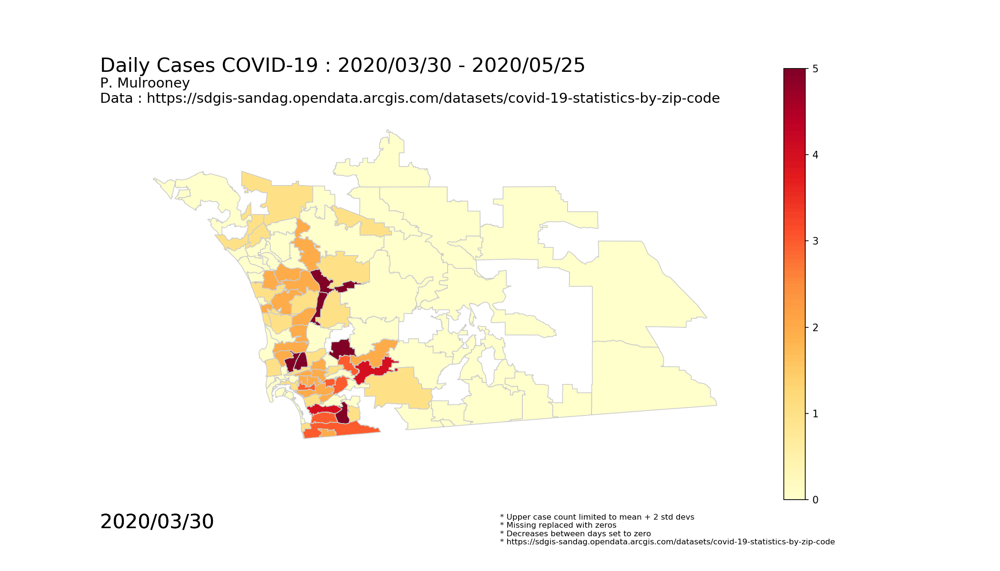

In [155]:
%%time
import imageio
images = []
for filename in filenames:
    images.append(imageio.imread(filename))
imageio.mimsave(output_path+'/movie.gif', images, duration=0.75, loop=1)

Image(filename=output_path+'/movie.gif') 

### Remove non-SD from geojson file...

#### Don't need to run again, just reference

In [156]:
import json

In [157]:
ifile = "/Users/pmulrooney/Downloads/ca_california_zip_codes_geo.min.json"
ofile = "/Users/pmulrooney/Downloads/ca_california_zip_codes_geo_sd.min.json"

with open(ifile) as fp:
    data = json.load(fp)

In [160]:
df.index.values

array(['91901', '91902', '91905', '91906', '91910', '91911', '91913',
       '91914', '91915', '91916', '91917', '91931', '91932', '91934',
       '91935', '91941', '91942', '91945', '91948', '91950', '91962',
       '91963', '91977', '91978', '91980', '92003', '92004', '92007',
       '92008', '92009', '92010', '92011', '92014', '92019', '92020',
       '92021', '92024', '92025', '92026', '92027', '92028', '92029',
       '92036', '92037', '92040', '92054', '92055', '92056', '92057',
       '92058', '92059', '92060', '92061', '92064', '92065', '92066',
       '92067', '92069', '92070', '92071', '92075', '92078', '92081',
       '92082', '92083', '92084', '92086', '92091', '92093', '92096',
       '92101', '92102', '92103', '92104', '92105', '92106', '92107',
       '92108', '92109', '92110', '92111', '92113', '92114', '92115',
       '92116', '92117', '92118', '92119', '92120', '92121', '92122',
       '92123', '92124', '92126', '92127', '92128', '92129', '92130',
       '92131', '921

In [161]:
known_zips = df.index.values

In [ ]:
known_zips = list(map(str,known_zips))

In [162]:
data.keys()

dict_keys(['type', 'features'])

In [163]:
new_data = {}
new_data['type'] = data['type']
new_data['features'] = []

In [164]:
data['features'][0].keys()

dict_keys(['type', 'properties', 'geometry'])

In [165]:
data['features'][0]['properties']['ZCTA5CE10']

'94601'

In [166]:
for i in data['features']:
    if i['properties']['ZCTA5CE10'] in known_zips:
        new_data['features'].append(i)

In [167]:
len(new_data['features'])

108

In [168]:
with open(ofile, 'w') as outfile:
    json.dump(new_data, outfile)

### Read GEOJSON???

In [169]:
sd_api = "https://opendata.arcgis.com/datasets/854d7e48e3dc451aa93b9daf82789089_0.geojson"

In [186]:
import requests
r = requests.get(sd_api)
rd =  [ _r['properties'] for _r in r.json()['features'] ]

In [195]:
pd.DataFrame(rd).head()

,FID,zipcode_zip,ziptext,case_count,updatedate,created_date,created_user,last_edited_date,last_edited_user,globalid
0,1,91901,91901,1.0,2020/04/01 08:00:00,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,{87C2AEFB-2AB8-473D-BE60-B021F0AD990A}
1,2,91902,91902,9.0,2020/04/01 08:00:00,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,{0BBF31F5-A98F-4A42-869E-F425379D6BA8}
2,3,91910,91910,23.0,2020/04/01 08:00:00,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,{94FEB6AB-AB77-4534-9692-CF8DFC823461}
3,4,91911,91911,21.0,2020/04/01 08:00:00,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,{83793CC0-427A-4747-9BDD-5D79A947C3FF}
4,5,91913,91913,20.0,2020/04/01 08:00:00,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,2020/04/11 18:43:45,Ross.Martin@sdcounty.ca.gov,{597D4C08-7AD1-49D2-811D-D54EE7C2BB13}
